In [63]:
import pandas as pd
import sys
from datetime import date, datetime
import matplotlib.pyplot as plt
import seaborn as sns

In [64]:
sys.path.insert(0,"...")
from nextbike.preprocessing.Preprocessor import Preprocessor

In [65]:
bremen= Preprocessor("../data/")


In [66]:
Preprocessor.clean_dataset(bremen)

Cleaning data set...
Filtered for city of Bremen.
Duplicates of subset [datetime, bike number] dropped.
Index reset.
Order of columns rearranged.
Null values dropped.
Cleaned data set saved in data/processed as bremen_cleaned.csv.
Cleaning data sucessfully finished.


In [67]:
bremen_cleaned = Preprocessor._get_cleaned(bremen)

In [68]:
bremen_cleaned.info()
bremen_cleaned.head()
bremen_cleaned.nunique()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 654495 entries, 0 to 654494
Data columns (total 13 columns):
 #   Column        Non-Null Count   Dtype         
---  ------        --------------   -----         
 0   datetime      654495 non-null  datetime64[ns]
 1   b_number      654495 non-null  int64         
 2   b_bike_type   654495 non-null  int64         
 3   p_spot        654495 non-null  bool          
 4   p_place_type  654495 non-null  int64         
 5   trip          654495 non-null  object        
 6   p_uid         654495 non-null  int64         
 7   p_bikes       654495 non-null  int64         
 8   p_name        654495 non-null  object        
 9   p_number      654495 non-null  float64       
 10  p_bike        654495 non-null  bool          
 11  p_lat         654495 non-null  float64       
 12  p_lng         654495 non-null  float64       
dtypes: bool(2), datetime64[ns](1), float64(3), int64(5), object(2)
memory usage: 56.2+ MB


datetime        186327
b_number           443
b_bike_type          2
p_spot               2
p_place_type         3
trip                 4
p_uid           157157
p_bikes             32
p_name            5973
p_number            79
p_bike               2
p_lat            25057
p_lng            85611
dtype: int64

In [9]:
#Preprocessor.create_trips(bremen)

Creating Trips from cleaned bike pings...


Finished rows:: 100%|████████████████| 654495/654495 [05:38<00:00, 1932.57it/s]


Trips data set saved in data/processed as trips.csv.
Creating trips from data completed successfully.


In [4]:
bremen_trips = pd.read_csv("../data/processed/trips.csv")
len(bremen_trips)

232845

### Anpassung mit code-snippet von Tim

In [5]:
bremen_trips = bremen_trips[(bremen_trips['start_lng'] != bremen_trips['end_lng']) | (bremen_trips['start_lat'] != bremen_trips['end_lat'])]
len(bremen_trips)

143677

In [6]:
bremen_trips.head()
bremen_trips.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 143677 entries, 8 to 232824
Data columns (total 12 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   bike            143677 non-null  int64  
 1   bike_type       143677 non-null  int64  
 2   identification  143677 non-null  int64  
 3   start_time      143677 non-null  object 
 4   end_time        143677 non-null  object 
 5   duration_sec    143677 non-null  float64
 6   start_lng       143677 non-null  float64
 7   start_lat       143677 non-null  float64
 8   end_lng         143677 non-null  float64
 9   end_lat         143677 non-null  float64
 10  start_place     143677 non-null  float64
 11  end_place       143677 non-null  float64
dtypes: float64(7), int64(3), object(2)
memory usage: 14.3+ MB


In [7]:
bremen_trips = bremen_trips.sort_values(by=['start_time'], ascending=True)

In [8]:
bremen_trips.head()

,bike,bike_type,identification,start_time,end_time,duration_sec,start_lng,start_lat,end_lng,end_lat,start_place,end_place
81821,20685,71,12099440,2019-01-20 00:13:00,2019-01-20 00:23:00,600.0,8.812554,53.076481,8.804828,53.084196,0.0,0.0
204560,20935,71,7873316,2019-01-20 00:35:00,2019-01-25 08:00:00,458700.0,8.816798,53.072448,8.811472,53.083167,0.0,2946.0
49030,20617,71,12099749,2019-01-20 00:40:00,2019-01-20 00:44:00,240.0,8.801623,53.067878,8.793217,53.064244,0.0,0.0
131464,20795,71,12099872,2019-01-20 00:47:00,2019-01-20 00:54:00,420.0,8.814744,53.084841,8.801135,53.094596,0.0,0.0
200261,20927,71,12100199,2019-01-20 01:07:00,2019-01-20 01:15:00,480.0,8.815254,53.084302,8.806666,53.094964,0.0,0.0


In [9]:
bremen_trips["start_time"] = pd.to_datetime(bremen_trips["start_time"])

In [10]:
for col in ['start_time']:
    bremen_trips['month'] = pd.DatetimeIndex(bremen_trips['start_time']).month
    bremen_trips['booking_date'] = bremen_trips.start_time.dt.date
    bremen_trips['weekdays'] = pd.DatetimeIndex(bremen_trips['start_time']).weekday
    bremen_trips['hour'] = pd.DatetimeIndex(bremen_trips['start_time']).hour



In [11]:
bremen_trips['booking_date'] = pd.to_datetime(bremen_trips['booking_date'])

In [12]:
display(bremen_trips.head(),bremen_trips.tail())

,bike,bike_type,identification,start_time,end_time,duration_sec,start_lng,start_lat,end_lng,end_lat,start_place,end_place,month,booking_date,weekdays,hour
81821,20685,71,12099440,2019-01-20 00:13:00,2019-01-20 00:23:00,600.0,8.812554,53.076481,8.804828,53.084196,0.0,0.0,1,2019-01-20,6,0
204560,20935,71,7873316,2019-01-20 00:35:00,2019-01-25 08:00:00,458700.0,8.816798,53.072448,8.811472,53.083167,0.0,2946.0,1,2019-01-20,6,0
49030,20617,71,12099749,2019-01-20 00:40:00,2019-01-20 00:44:00,240.0,8.801623,53.067878,8.793217,53.064244,0.0,0.0,1,2019-01-20,6,0
131464,20795,71,12099872,2019-01-20 00:47:00,2019-01-20 00:54:00,420.0,8.814744,53.084841,8.801135,53.094596,0.0,0.0,1,2019-01-20,6,0
200261,20927,71,12100199,2019-01-20 01:07:00,2019-01-20 01:15:00,480.0,8.815254,53.084302,8.806666,53.094964,0.0,0.0,1,2019-01-20,6,1


,bike,bike_type,identification,start_time,end_time,duration_sec,start_lng,start_lat,end_lng,end_lat,start_place,end_place,month,booking_date,weekdays,hour
220079,20965,71,26519958,2019-12-31 23:41:00,2019-12-31 23:49:00,480.0,8.871098,53.077498,8.872118,53.082471,0.0,0.0,12,2019-12-31,1,23
116087,20757,71,26520201,2019-12-31 23:44:00,2019-12-31 23:59:00,900.0,8.821334,53.081942,8.806207,53.078418,0.0,0.0,12,2019-12-31,1,23
209971,20946,71,26520104,2019-12-31 23:48:00,2019-12-31 23:55:00,420.0,8.779235,53.078581,8.790776,53.078867,2966.0,0.0,12,2019-12-31,1,23
123555,20776,71,26520101,2019-12-31 23:48:00,2019-12-31 23:55:00,420.0,8.779235,53.078581,8.790580,53.078867,2966.0,0.0,12,2019-12-31,1,23
113816,20751,71,26520148,2019-12-31 23:51:00,2019-12-31 23:57:00,360.0,8.815570,53.054449,8.811623,53.060347,0.0,0.0,12,2019-12-31,1,23


In [13]:
bremen_trips["duration_sec"].describe().astype(int)   # kann mir nicht so viel unter Sekunden vorstellen

count      143677
mean        14940
std        222884
min           120
25%           480
50%           780
75%          1320
max      21399300
Name: duration_sec, dtype: int32

In [14]:
bremen_trips["duration_min"] = bremen_trips["duration_sec"]/60

In [15]:
bremen_trips["duration_min"].describe().astype(int)

count    143677
mean        249
std        3714
min           2
25%           8
50%          13
75%          22
max      356655
Name: duration_min, dtype: int32

wir haben hier deutliche Ausreißer. Das sieht man dran, dass 75% der Trips eine Dauer von <=16 Minuten haben, aber der mean bei 157 liegt, während Median bei 7 Minuten liegt

In [16]:
#most popular roads: start_place zu end_place
most_pr = (
    bremen_trips.groupby(['start_place', 'end_place'])
      .agg({'duration_min':['count','min','max','mean','median','std','var']})
      .reset_index().sort_values(('duration_min','count'), ascending=False)
)
most_pr.head(n=10)



start_place end_place duration_min                                     \
                                  count  min       max         mean median   
0            0.0       0.0        88174  2.0  204830.0    78.021650   12.0   
947       2946.0       0.0         3632  2.0   41121.0    82.987610   12.0   
36           0.0    2946.0         2886  2.0  217282.0  2287.331947   18.0   
79        2910.0       0.0         1309  2.0   19746.0    81.661574   11.0   
1            0.0    2910.0         1007  2.0   40421.0   324.451837   11.0   
1822      2977.0       0.0          855  2.0   17919.0    97.913450   12.0   
67           0.0    2977.0          805  2.0  126985.0   920.332919   17.0   
1419      2963.0       0.0          689  2.0    8994.0   102.873730   22.0   
1347      2961.0       0.0          672  2.0   10129.0    72.708333   14.0   
173       2912.0       0.0          587  2.0    7689.0   124.231687   22.0   

                                 
              std           var  
0     1325.421766  1.756743e+06  
947    764.557753  5.845486e+05  
36    9324.183159  8.694039e+07  
79     690.944430  4.774042e+05  
1     2295.746753  5.270453e+06  
1822   696.330926  4.848768e+05  
67    6047.612350  3.657362e+07  
1419   566.821890  3.212871e+05  
1347   510.796796  2.609134e+05  
173    639.023322  4.083508e+05

In [17]:
# Most popular zones
bremen_trips.start_place.value_counts()
df_origin_freq = bremen_trips.start_place.value_counts().reset_index()
df_origin_freq.rename(
    columns={
        "index": "rental_zone",
        "start_place": "start",
    },
    inplace=True
)
df_origin_freq
df_origin_freq.columns = ['rental_zone','start']
df_dest_freq = bremen_trips.end_place.value_counts().reset_index()
df_dest_freq.rename(
    columns={
        "index": "rental_zone",
        "start_place": "end",
    },
    inplace=True
)
df_dest_freq.columns = ['rental_zone','end']

popular_zones_merged = pd.merge(df_origin_freq, df_dest_freq, on='rental_zone')
popular_zones_merged['diff'] = popular_zones_merged.end - popular_zones_merged.start
popular_zones_merged

,rental_zone,start,end,diff
0,0.0,109965,113685,3720
1,2946.0,4679,4129,-550
2,2910.0,1674,1432,-242
3,2977.0,1152,1057,-95
4,2963.0,899,849,-50
...,...,...,...,...
74,2947.0,44,35,-9
75,2920.0,30,27,-3
76,2927.0,18,19,1
77,29860.0,18,17,-1


In [18]:
popular_zones_merged.sort_values('diff').head()

,rental_zone,start,end,diff
1,2946.0,4679,4129,-550
2,2910.0,1674,1432,-242
22,2936.0,492,342,-150
37,2962.0,389,261,-128
16,2941.0,609,483,-126


In [19]:
# High bicycle supply
popular_zones_merged.sort_values('diff', ascending=False).head()

,rental_zone,start,end,diff
0,0.0,109965,113685,3720
71,2917.0,49,66,17
48,2939.0,257,261,4
68,2943.0,72,76,4
67,2954.0,105,109,4


## Spatial analysis

In [20]:
bremen_trips.head()

,bike,bike_type,identification,start_time,end_time,duration_sec,start_lng,start_lat,end_lng,end_lat,start_place,end_place,month,booking_date,weekdays,hour,duration_min
81821,20685,71,12099440,2019-01-20 00:13:00,2019-01-20 00:23:00,600.0,8.812554,53.076481,8.804828,53.084196,0.0,0.0,1,2019-01-20,6,0,10.0
204560,20935,71,7873316,2019-01-20 00:35:00,2019-01-25 08:00:00,458700.0,8.816798,53.072448,8.811472,53.083167,0.0,2946.0,1,2019-01-20,6,0,7645.0
49030,20617,71,12099749,2019-01-20 00:40:00,2019-01-20 00:44:00,240.0,8.801623,53.067878,8.793217,53.064244,0.0,0.0,1,2019-01-20,6,0,4.0
131464,20795,71,12099872,2019-01-20 00:47:00,2019-01-20 00:54:00,420.0,8.814744,53.084841,8.801135,53.094596,0.0,0.0,1,2019-01-20,6,0,7.0
200261,20927,71,12100199,2019-01-20 01:07:00,2019-01-20 01:15:00,480.0,8.815254,53.084302,8.806666,53.094964,0.0,0.0,1,2019-01-20,6,1,8.0


In [21]:
import folium
from folium.plugins import HeatMapWithTime

In [22]:
def generateBaseMap(default_location=[53.073635,8.806422], default_zoom_start=12):
    base_map = folium.Map(location=default_location, control_scale=True, zoom_start=default_zoom_start)
    return base_map

def generateHeat()
    HeatMap(data=df_copy[['start_lat', 'start_lng', 'duration_min']].groupby(['start_lat', 'start_lng']).sum().reset_index().values.tolist(), radius=8, max_zoom=13).add_to(base_map)

def generateHeatWithTime()
    HeatMapWithTime(df_hour_list, radius=5, gradient={0.2: 'blue', 0.4: 'lime', 0.6: 'orange', 1: 'red'}, min_opacity=0.5, max_opacity=0.8, use_local_extrema=True).add_to(base_map)


def generateAll()

In [23]:
base_map = generateBaseMap()
base_map

### Heatmap der Startpunkte

In [24]:
from folium.plugins import HeatMap
df_copy = bremen_trips
#df_copy['count'] = 1
base_map = generateBaseMap()
HeatMap(data=df_copy[['start_lat', 'start_lng', 'duration_min']].groupby(['start_lat', 'start_lng']).sum().reset_index().values.tolist(), radius=8, max_zoom=13).add_to(base_map)
base_map

### Heatmap der Endpunkte

In [25]:
base_map = generateBaseMap()
HeatMap(data=df_copy[['end_lat', 'end_lng', 'duration_min']].groupby(['end_lat', 'end_lng']).sum().reset_index().values.tolist(), radius=8, max_zoom=13).add_to(base_map)
base_map

Die Heatmaps ermöglichen es uns, die beliebtesten Routen zu erkennen. Wie genau muss ich noch herausfinden ^^

### Dynamische Heatmap nach Stunden

In [26]:
df_hour_list = []
for hour in df_copy.hour.sort_values().unique():
    df_hour_list.append(df_copy.loc[df_copy.hour == hour, ['start_lat', 'start_lng', 'duration_min']].groupby(['start_lat', 'start_lng']).sum().reset_index().values.tolist())

In [27]:
base_map = generateBaseMap(default_zoom_start=12)
HeatMapWithTime(df_hour_list, radius=5, gradient={0.2: 'blue', 0.4: 'lime', 0.6: 'orange', 1: 'red'}, min_opacity=0.5, max_opacity=0.8, use_local_extrema=True).add_to(base_map)
base_map

### Dynamische Heatmap nach Wochentagen

In [28]:
df_weekdays_list = []
for weekdays in df_copy.weekdays.sort_values().unique():
    df_weekdays_list.append(df_copy.loc[df_copy.weekdays == weekdays, ['start_lat', 'start_lng', 'duration_min']].groupby(['start_lat', 'start_lng']).sum().reset_index().values.tolist())

In [29]:
base_map = generateBaseMap(default_zoom_start=12)
HeatMapWithTime(df_weekdays_list, radius=5, gradient={0.2: 'blue', 0.4: 'lime', 0.6: 'orange', 1: 'red'}, min_opacity=0.5, max_opacity=0.8, use_local_extrema=True).add_to(base_map)
base_map

### Dynamische Heatmap nach Monaten

In [30]:
df_hour_list = []
for month in df_copy.month.sort_values().unique():
    df_hour_list.append(df_copy.loc[df_copy.month == month, ['start_lat', 'start_lng', 'duration_min']].groupby(['start_lat', 'start_lng']).sum().reset_index().values.tolist())

In [31]:

base_map = generateBaseMap(default_zoom_start=12)
HeatMapWithTime(df_hour_list, radius=5, gradient={0.2: 'blue', 0.4: 'lime', 0.6: 'orange', 1: 'red'}, min_opacity=0.5, max_opacity=0.8, use_local_extrema=True).add_to(base_map)
base_map

### 2.a Visualization of # started trips per PLZ region

Wie bekomme ich die PLZ?
- Letzter triple A workshop, polygone für PLZ erstellen
- Geo.json hat bereits die Viertel, evtl matchen / bereits vorhanden
- Geo.json mit PLZ von Deutschland matchen
- eine Zeile = ein Trip für # trips
- station information.json -> irgendwo festival !!! 2920
- Uni Bremen, Messe Bremen
https://github.com/yetzt/postleitzahlen


### 2.b For one moment in time, visualize the number of bikes at fixed stations meaningfully.

Habt ihr eine Idee für einen interessanten Moment, den man genauer betrachten könnte? Kenn mich mit Fußball nicht aus, aber ein entscheidendes Spiel bspw. 
- Breminale 04.07 - 06.07 -> fehlt!
- Hafentage 
- Vatertag #bollerwagen
- start / end_place.nunique um die Stationen zu erhalten
- irgendwo festival
- Peak 24.01 600 bookings: Demonstration am Bremer Marktplatz 53.075890, 8.807021
- Peak

### 2.c Create a heatmap based on an interesting aspect of the data, e.g., end locations of trips shortly before the start of a major public event.

Text(0.5, 1.0, 'January')

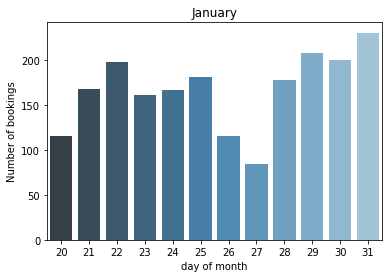

In [33]:
day_of_month_jan = bremen_trips[bremen_trips['start_time'].dt.month == 1].start_time.dt.day.value_counts()
ax = sns.barplot(x=day_of_month_jan.index, y=day_of_month_jan, palette="Blues_d")
ax.set(ylabel='Number of bookings', xlabel='day of month') 
ax.set_title('January')

### 24.01 (627) Demo am bremer Marktplatz 53.075890, 8.807021

In [34]:
# Peak 24.01 600 bookings: Demonstration am Bremer Marktplatz 53.075890, 8.807021
df_2401 = bremen_trips.loc[bremen_trips.booking_date == '2019-01-24']
df_2401
#display(len(df_2401.duplicated(keep=False)),df_2401)

,bike,bike_type,identification,start_time,end_time,duration_sec,start_lng,start_lat,end_lng,end_lat,start_place,end_place,month,booking_date,weekdays,hour,duration_min
115205,20756,71,11119973,2019-01-24 00:24:00,2019-01-24 07:30:00,25560.0,8.812664,53.082556,8.759247,53.099552,0.0,2913.0,1,2019-01-24,3,0,426.0
159462,20847,71,12194769,2019-01-24 00:43:00,2019-01-24 00:56:00,780.0,8.816064,53.081564,8.804357,53.061418,0.0,0.0,1,2019-01-24,3,0,13.0
134604,20800,71,12198131,2019-01-24 00:47:00,2019-01-24 06:22:00,20100.0,8.811472,53.083167,8.815594,53.080844,2946.0,0.0,1,2019-01-24,3,0,335.0
101183,20725,71,12195568,2019-01-24 01:05:00,2019-01-24 02:20:00,4500.0,8.827928,53.081715,8.827844,53.081564,0.0,0.0,1,2019-01-24,3,1,75.0
145300,20820,71,12195675,2019-01-24 02:12:00,2019-01-24 02:30:00,1080.0,8.833496,53.077452,8.809140,53.090636,0.0,0.0,1,2019-01-24,3,2,18.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
67731,20653,71,8615035,2019-01-24 22:30:00,2019-01-25 20:16:00,78360.0,8.908522,53.145551,8.909947,53.145798,0.0,2953.0,1,2019-01-24,3,22,1306.0
159466,20847,71,12217520,2019-01-24 22:39:00,2019-01-24 23:10:00,1860.0,8.794222,53.071972,8.803721,53.061911,2955.0,0.0,1,2019-01-24,3,22,31.0
185713,20898,71,12217622,2019-01-24 23:09:00,2019-01-24 23:17:00,480.0,8.786056,53.053111,8.787840,53.054133,2911.0,0.0,1,2019-01-24,3,23,8.0
88485,20700,71,12218110,2019-01-24 23:37:00,2019-01-25 00:06:00,1740.0,8.849472,53.085000,8.852178,53.084449,2961.0,0.0,1,2019-01-24,3,23,29.0


In [35]:
# 24.01 Demonstration gegen Paragraf 219a am Bremer Markplatz --> Start

df_hour_list = []
for hour in df_2401.hour.sort_values().unique():
    df_hour_list.append(df_2401.loc[df_2401.hour == hour, ['start_lat', 'start_lng', 'duration_min']].groupby(['start_lat', 'start_lng']).sum().reset_index().values.tolist())
    
base_map = generateBaseMap(default_location=[53.075890,8.807021],default_zoom_start=12)
HeatMapWithTime(df_hour_list, radius=5, gradient={0.2: 'blue', 0.4: 'lime', 0.6: 'orange', 1: 'red'}, min_opacity=0.5, max_opacity=0.8, use_local_extrema=True).add_to(base_map)
base_map

#extrem viele Buchungen um 9 Uhr Morgens für Start!

In [36]:
# 24.01 Demonstration gegen Paragraf 219a am Bremer Markplatz --> End

df_hour_list = []
for hour in df_2401.hour.sort_values().unique():
    df_hour_list.append(df_2401.loc[df_2401.hour == hour, ['end_lat', 'end_lng', 'duration_min']].groupby(['end_lat', 'end_lng']).sum().reset_index().values.tolist())
    
base_map = generateBaseMap(default_location=[53.075890,8.807021],default_zoom_start=12)
HeatMapWithTime(df_hour_list, radius=5, gradient={0.2: 'blue', 0.4: 'lime', 0.6: 'orange', 1: 'red'}, min_opacity=0.5, max_opacity=0.8, use_local_extrema=True).add_to(base_map)
base_map

#extrem viele Buchungen um 9 Uhr Morgens für Start!

### 12.02 (5592) und 13.02 (5387) 
-> vermutlich falsche Werte, viele identische Start & End Zeiten trotz unterschiedlicher Bike IDs

In [37]:
#12.02 
df_1202 = bremen_trips.loc[bremen_trips['booking_date'] == "2019-02-12"]
display(len(df_1202.duplicated(['start_time', 'end_time'],keep='last')),df_1202)

294

,bike,bike_type,identification,start_time,end_time,duration_sec,start_lng,start_lat,end_lng,end_lat,start_place,end_place,month,booking_date,weekdays,hour,duration_min
132057,20796,71,12704914,2019-02-12 00:31:00,2019-02-12 06:52:00,22860.0,8.812589,53.082827,8.807917,53.073933,0.0,0.0,2,2019-02-12,1,0,381.0
123586,20777,71,12703768,2019-02-12 02:51:00,2019-02-12 05:12:00,8460.0,8.810553,53.082031,8.810806,53.081902,0.0,0.0,2,2019-02-12,1,2,141.0
60009,20640,71,12705248,2019-02-12 03:38:00,2019-02-12 07:16:00,13080.0,8.814531,53.082591,8.798262,53.084018,0.0,0.0,2,2019-02-12,1,3,218.0
99396,20721,71,12703211,2019-02-12 04:32:00,2019-02-12 04:39:00,420.0,8.816619,53.083373,8.835127,53.084573,0.0,0.0,2,2019-02-12,1,4,7.0
199572,20925,71,7873169,2019-02-12 05:02:00,2019-02-12 05:23:00,1260.0,8.945250,53.158160,8.898528,53.127139,2943.0,2939.0,2,2019-02-12,1,5,21.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
138665,20807,71,12714722,2019-02-12 23:27:00,2019-02-12 23:31:00,240.0,8.836716,53.076628,8.836862,53.076525,0.0,0.0,2,2019-02-12,1,23,4.0
177739,20884,71,12708675,2019-02-12 23:27:00,2019-02-12 23:31:00,240.0,8.911033,53.078441,8.910963,53.078372,0.0,0.0,2,2019-02-12,1,23,4.0
137338,20804,71,12719443,2019-02-12 23:27:00,2019-02-12 23:31:00,240.0,8.901624,53.083040,8.902717,53.083000,0.0,0.0,2,2019-02-12,1,23,4.0
204730,20936,71,12719623,2019-02-12 23:50:00,2019-02-12 23:57:00,420.0,8.787377,53.081970,8.797969,53.080467,0.0,0.0,2,2019-02-12,1,23,7.0


In [38]:
#12.02 Dienstag, START keine besonderen Veranstaltungen laut google --> extremer traffic von 13 bis 23 Uhr
df_hour_list = []
for hour in df_1202.hour.sort_values().unique():
    df_hour_list.append(df_1202.loc[df_1202.hour == hour, ['start_lat', 'start_lng', 'duration_min']].groupby(['start_lat', 'start_lng']).sum().reset_index().values.tolist())
    
base_map = generateBaseMap(default_location=[53.075890,8.807021],default_zoom_start=12)
HeatMapWithTime(df_hour_list, radius=5, gradient={0.2: 'blue', 0.4: 'lime', 0.6: 'orange', 1: 'red'}, min_opacity=0.5, max_opacity=0.8, use_local_extrema=True).add_to(base_map)
base_map


In [39]:
#12.02 Dienstag, END keine besonderen Veranstaltungen laut google --> extremer traffic von 13 bis 23 Uhr
df_hour_list = []
for hour in df_1202.hour.sort_values().unique():
    df_hour_list.append(df_1202.loc[df_1202.hour == hour, ['end_lat', 'end_lng', 'duration_min']].groupby(['end_lat', 'end_lng']).sum().reset_index().values.tolist())
    
base_map = generateBaseMap(default_location=[53.075890,8.807021],default_zoom_start=12)
HeatMapWithTime(df_hour_list, radius=5, gradient={0.2: 'blue', 0.4: 'lime', 0.6: 'orange', 1: 'red'}, min_opacity=0.5, max_opacity=0.8, use_local_extrema=True).add_to(base_map)
base_map

In [40]:
#13.02 Mittwoch, keine besonderen veranstaltungen laut google
df_1302 = bremen_trips.loc[bremen_trips['booking_date'] == "2019-02-13"]
display(df_1302,len(df_1302.duplicated(['start_time', 'end_time'],keep='last')))

,bike,bike_type,identification,start_time,end_time,duration_sec,start_lng,start_lat,end_lng,end_lat,start_place,end_place,month,booking_date,weekdays,hour,duration_min
166408,20861,71,12717712,2019-02-13 00:03:00,2019-02-13 00:05:00,120.0,8.790626,53.090058,8.790617,53.090073,0.0,0.0,2,2019-02-13,2,0,2.0
62831,20645,71,12609009,2019-02-13 00:03:00,2019-02-13 00:05:00,120.0,8.846716,53.068473,8.846763,53.068412,0.0,0.0,2,2019-02-13,2,0,2.0
215522,20958,71,12719131,2019-02-13 00:18:00,2019-02-13 00:24:00,360.0,8.838701,53.082342,8.838653,53.082427,0.0,0.0,2,2019-02-13,2,0,6.0
159058,20846,71,12708779,2019-02-13 00:18:00,2019-02-13 00:24:00,360.0,8.816150,53.083326,8.816247,53.083289,0.0,0.0,2,2019-02-13,2,0,6.0
140114,20809,71,12642017,2019-02-13 00:18:00,2019-02-13 00:24:00,360.0,8.812609,53.059095,8.812649,53.059116,0.0,0.0,2,2019-02-13,2,0,6.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72610,20664,71,12736841,2019-02-13 22:51:00,2019-02-13 22:57:00,360.0,8.892528,53.079667,8.877062,53.081098,2931.0,0.0,2,2019-02-13,2,22,6.0
117466,20766,71,12737005,2019-02-13 23:06:00,2019-02-13 23:17:00,660.0,8.897893,53.080273,8.883073,53.086076,0.0,0.0,2,2019-02-13,2,23,11.0
58577,20636,71,12737259,2019-02-13 23:39:00,2019-02-13 23:48:00,540.0,8.817203,53.085888,8.847402,53.086591,0.0,0.0,2,2019-02-13,2,23,9.0
209200,20945,71,12737280,2019-02-13 23:44:00,2019-02-13 23:50:00,360.0,8.807284,53.064713,8.796088,53.064053,0.0,0.0,2,2019-02-13,2,23,6.0


304

In [41]:
#13.02 -> extremer traffic von 1 bis 8 Uhr Morgens
#bremen before:2019-02-15 after:2019-02-11
df_hour_list = []
for hour in df_1302.hour.sort_values().unique():
    df_hour_list.append(df_1302.loc[df_1302.hour == hour, ['start_lat', 'start_lng', 'duration_min']].groupby(['start_lat', 'start_lng']).sum().reset_index().values.tolist())
    
base_map = generateBaseMap(default_location=[53.075890,8.807021],default_zoom_start=12)
HeatMapWithTime(df_hour_list, radius=5, gradient={0.2: 'blue', 0.4: 'lime', 0.6: 'orange', 1: 'red'}, min_opacity=0.5, max_opacity=0.8, use_local_extrema=True).add_to(base_map)
base_map

### 04.03 (6491)

Text(0.5, 1.0, 'march')

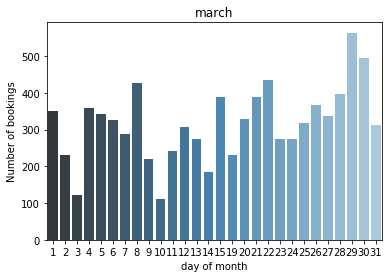

In [42]:
#Distribution Number of bookings per month
# bremen_trips.start_time.dt.day.value_counts()
day_of_month_jan = bremen_trips[bremen_trips['start_time'].dt.month == 3].start_time.dt.day.value_counts()
ax = sns.barplot(x=day_of_month_jan.index, y=day_of_month_jan, palette="Blues_d")
ax.set(ylabel='Number of bookings', xlabel='day of month') 
ax.set_title('march')

In [43]:
#04.03 Montag, keine besonderen veranstaltungen laut google
df_0403 = bremen_trips.loc[bremen_trips['booking_date'] == "2019-03-04"]
display(df_0403.head(5),len(df_0403.duplicated(['start_time', 'end_time'],keep='last')))

,bike,bike_type,identification,start_time,end_time,duration_sec,start_lng,start_lat,end_lng,end_lat,start_place,end_place,month,booking_date,weekdays,hour,duration_min
203218,20932,71,7873483,2019-03-04 00:00:00,2019-03-04 00:14:00,840.0,8.811472,53.083167,8.785476,53.068565,2946.0,2952.0,3,2019-03-04,0,0,14.0
144794,20819,71,13120885,2019-03-04 00:05:00,2019-03-04 00:16:00,660.0,8.806731,53.078872,8.789019,53.071160,0.0,0.0,3,2019-03-04,0,0,11.0
187723,20902,71,7873056,2019-03-04 00:07:00,2019-03-04 00:36:00,1740.0,8.811713,53.081373,8.786056,53.053111,0.0,2911.0,3,2019-03-04,0,0,29.0
62187,20644,71,13121215,2019-03-04 00:34:00,2019-03-04 00:53:00,1140.0,8.824421,53.073249,8.784267,53.065760,0.0,0.0,3,2019-03-04,0,0,19.0
211824,20951,71,7873436,2019-03-04 02:19:00,2019-03-04 02:45:00,1560.0,8.816083,53.072213,8.850111,53.041500,0.0,2950.0,3,2019-03-04,0,2,26.0


358

In [44]:
#04.03 START starker peak von 12 bis 16 uhr, danach normal
df_hour_list = []
for hour in df_0403.hour.sort_values().unique():
    df_hour_list.append(df_0403.loc[df_0403.hour == hour, ['start_lat', 'start_lng', 'duration_min']].groupby(['start_lat', 'start_lng']).sum().reset_index().values.tolist())
    
base_map = generateBaseMap(default_location=[53.075890,8.807021],default_zoom_start=12)
HeatMapWithTime(df_hour_list, radius=5, gradient={0.2: 'blue', 0.4: 'lime', 0.6: 'orange', 1: 'red'}, min_opacity=0.5, max_opacity=0.8, use_local_extrema=True).add_to(base_map)
base_map

In [45]:
#04.03 END
df_hour_list = []
for hour in df_0403.hour.sort_values().unique():
    df_hour_list.append(df_0403.loc[df_0403.hour == hour, ['end_lat', 'end_lng', 'duration_min']].groupby(['end_lat', 'end_lng']).sum().reset_index().values.tolist())
    
base_map = generateBaseMap(default_location=[53.075890,8.807021],default_zoom_start=12)
HeatMapWithTime(df_hour_list, radius=5, gradient={0.2: 'blue', 0.4: 'lime', 0.6: 'orange', 1: 'red'}, min_opacity=0.5, max_opacity=0.8, use_local_extrema=True).add_to(base_map)
base_map

### 12.04 (3816)

Text(0.5, 1.0, 'April')

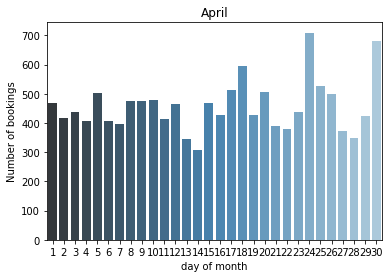

In [46]:
#Distribution Number of bookings per month
# bremen_trips.start_time.dt.day.value_counts()
day_of_month_jan = bremen_trips[bremen_trips['start_time'].dt.month == 4].start_time.dt.day.value_counts()
ax = sns.barplot(x=day_of_month_jan.index, y=day_of_month_jan, palette="Blues_d")
ax.set(ylabel='Number of bookings', xlabel='day of month') 
ax.set_title('April')

In [47]:
#12.04 Freitag, keine besonderen veranstaltungen laut google bremen before:2019-04-14 after:2019-04-11
#
df_1204 = bremen_trips.loc[bremen_trips['booking_date'] == "2019-04-12"]
display(df_1204.head(5),len(df_1204.duplicated(['start_time', 'end_time'],keep='last')))

,bike,bike_type,identification,start_time,end_time,duration_sec,start_lng,start_lat,end_lng,end_lat,start_place,end_place,month,booking_date,weekdays,hour,duration_min
30238,20579,71,14384896,2019-04-12 00:25:00,2019-04-12 00:42:00,1020.0,8.801345,53.065787,8.826636,53.082556,0.0,0.0,4,2019-04-12,4,0,17.0
78121,20675,71,14384874,2019-04-12 00:26:00,2019-04-12 00:40:00,840.0,8.801200,53.065862,8.805375,53.083209,0.0,0.0,4,2019-04-12,4,0,14.0
201668,20929,71,14385126,2019-04-12 00:58:00,2019-04-12 01:01:00,180.0,8.864673,53.081529,8.860746,53.079382,0.0,0.0,4,2019-04-12,4,0,3.0
180455,20888,71,14385441,2019-04-12 01:10:00,2019-04-12 01:24:00,840.0,8.811472,53.083167,8.806003,53.082187,2946.0,0.0,4,2019-04-12,4,1,14.0
176149,20880,71,14385700,2019-04-12 01:25:00,2019-04-12 01:42:00,1020.0,8.779235,53.078581,8.817975,53.095347,2966.0,0.0,4,2019-04-12,4,1,17.0


464

In [48]:
#12.04 START  --> extremer peak um 4 uhr morgens, danach wieder ganz normal???
df_hour_list = []
for hour in df_1204.hour.sort_values().unique():
    df_hour_list.append(df_1204.loc[df_1204.hour == hour, ['start_lat', 'start_lng', 'duration_min']].groupby(['start_lat', 'start_lng']).sum().reset_index().values.tolist())
    
base_map = generateBaseMap(default_location=[53.075890,8.807021],default_zoom_start=12)
HeatMapWithTime(df_hour_list, radius=5, gradient={0.2: 'blue', 0.4: 'lime', 0.6: 'orange', 1: 'red'}, min_opacity=0.5, max_opacity=0.8, use_local_extrema=True).add_to(base_map)
base_map

In [49]:
#12.04 END
df_hour_list = []
for hour in df_1204.hour.sort_values().unique():
    df_hour_list.append(df_1204.loc[df_1204.hour == hour, ['end_lat', 'end_lng', 'duration_min']].groupby(['end_lat', 'end_lng']).sum().reset_index().values.tolist())
    
base_map = generateBaseMap(default_location=[53.075890,8.807021],default_zoom_start=12)
HeatMapWithTime(df_hour_list, radius=5, gradient={0.2: 'blue', 0.4: 'lime', 0.6: 'orange', 1: 'red'}, min_opacity=0.5, max_opacity=0.8, use_local_extrema=True).add_to(base_map)
base_map

### 06.03.19 Besuch der Royals in Bremen
https://www.weser-kurier.de/bremen/bremen-stadt_artikel,-niederlande-setzen-auf-zusammenarbeit-_arid,1812150.html
https://www.weser-kurier.de/bremen_artikel,-diese-orte-besucht-das-niederlaendische-koenigspaar-in-bremen-_arid,1811403.html
    
The Netherlands would like to further consolidate its relations with Bremen. Over 340 companies from the Hanseatic city have trade relations with the Netherlands. That means, they either have branches, foreign representatives or production facilities in the country or they import or export goods. Accompanied by a business delegation, Queen Máxima and King Willem-Alexander visited the state and companies in the fields of space travel, wind energy and polar and marine research in Bremen and Bremerhaven on Wednesday, the 6th of march 2019. Representatives of the commissions reached agreements for closer economic cooperation.

Rough timeline:
- 10:50 Bremen airport @ Airbus Defence & Space Bremen 53.052908, 8.794159
- 12:00 Bremen Rathhaus Kings's speech 53.076209, 8.807911
- ~ 14:00 via Marktplatz to Bremer Stadtmusikanten 53.076435, 8.807514
- ~ 15:00 Handelskammer Bremen 53.075745, 8.806354
- ~ 18:00 Bremerhaven @ Fraunhofer-Institut für Windenergiesysteme 53.519505, 8.571213
- 19:00 Bremerhaven @ Alfred-Wegener-Institut 53.533459, 8.580462
- ROADBLOCKS from 11:00 until 15:00 @ streets around Marktplatz (Stintbrücke, Langenstraße, Hakenstraße and Am Markt) 


In [50]:
#06.03 Mittwoch, Besuch der Königsfamilie Niederlande #356 booking_trips
#
df_0603 = bremen_trips.loc[bremen_trips['booking_date'] == "2019-03-06"]
display(df_0603,len(df_0603.duplicated(['start_time', 'end_time'],keep='last')))

,bike,bike_type,identification,start_time,end_time,duration_sec,start_lng,start_lat,end_lng,end_lat,start_place,end_place,month,booking_date,weekdays,hour,duration_min
70250,20658,71,13169054,2019-03-06 00:35:00,2019-03-06 00:40:00,300.0,8.793556,53.066556,8.792286,53.059836,2941.0,0.0,3,2019-03-06,2,0,5.0
54958,20629,71,13169227,2019-03-06 00:51:00,2019-03-06 00:57:00,360.0,8.813934,53.082147,8.827671,53.078147,0.0,0.0,3,2019-03-06,2,0,6.0
84870,20692,71,13169640,2019-03-06 01:15:00,2019-03-06 01:33:00,1080.0,8.580278,53.182889,8.614654,53.174258,2927.0,0.0,3,2019-03-06,2,1,18.0
140181,20809,71,13170964,2019-03-06 02:48:00,2019-03-06 03:06:00,1080.0,8.903858,53.109340,8.865102,53.104364,0.0,0.0,3,2019-03-06,2,2,18.0
69663,20657,71,13171587,2019-03-06 03:39:00,2019-03-06 03:48:00,540.0,8.898552,53.084394,8.911414,53.078409,0.0,0.0,3,2019-03-06,2,3,9.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
100887,20724,71,13196812,2019-03-06 22:53:00,2019-03-06 23:03:00,600.0,8.799824,53.077811,8.789019,53.069204,2990.0,0.0,3,2019-03-06,2,22,10.0
163432,20854,71,13196908,2019-03-06 22:55:00,2019-03-06 23:09:00,840.0,8.827890,53.072561,8.799282,53.064404,0.0,0.0,3,2019-03-06,2,22,14.0
49068,20617,71,7873007,2019-03-06 22:59:00,2019-03-06 23:36:00,2220.0,8.824075,53.076872,8.810182,53.074592,0.0,2933.0,3,2019-03-06,2,22,37.0
120183,20771,71,13197336,2019-03-06 23:06:00,2019-03-06 23:44:00,2280.0,8.805019,53.081846,8.799378,53.096778,0.0,0.0,3,2019-03-06,2,23,38.0


326

In [51]:
# Heatmap über gesamten Tag
base_map = generateBaseMap()
HeatMap(data=df_0603[['end_lat', 'end_lng', 'duration_min']].groupby(['end_lat', 'end_lng']).sum().reset_index().values.tolist(), radius=8, max_zoom=13).add_to(base_map)
base_map

In [52]:
#dynamische Heatmap über gesamten Tag
#12.04 END
df_hour_list = []
for hour in df_0603.hour.sort_values().unique():
    df_hour_list.append(df_0603.loc[df_0603.hour == hour, ['end_lat', 'end_lng', 'duration_min']].groupby(['end_lat', 'end_lng']).sum().reset_index().values.tolist())
    
base_map = generateBaseMap(default_location=[53.076435,8.807514],default_zoom_start=12)
HeatMapWithTime(df_hour_list, radius=5, gradient={0.2: 'blue', 0.4: 'lime', 0.6: 'orange', 1: 'red'}, min_opacity=0.5, max_opacity=0.8, use_local_extrema=True).add_to(base_map)
base_map

### 31.05 ebenfalls kein besonderes event
bremen  before:2019-06-02 after:2019-05-30

Text(0.5, 1.0, 'Juni')

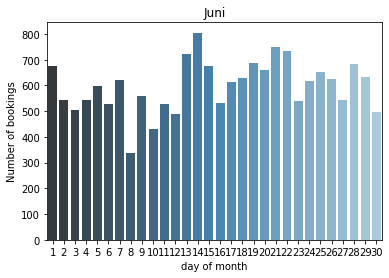

In [53]:
#Distribution Number of bookings per month
# bremen_trips.start_time.dt.day.value_counts()
day_of_month_jan = bremen_trips[bremen_trips['start_time'].dt.month == 6].start_time.dt.day.value_counts()
ax = sns.barplot(x=day_of_month_jan.index, y=day_of_month_jan, palette="Blues_d")
ax.set(ylabel='Number of bookings', xlabel='day of month') 
ax.set_title('Juni')

### 15.06 Samstag. #2025 Künstlerfestival, OPEN CAMPUS UNI BREMEN 53.108610, 8.853722,  verkaufsoffener Sonntag Strasse Am Wall 53.079705, 8.806789 etc.
Das internationale Straßenkünstlerfestival „La Strada“, das Wallfest mit einem „Faltrad- und Klappradrennen sowie eine „Freizeitmeile“ in der Lloyd-Passage locken die Flaneure, Seh-Leute und Einkäufer am Samstag und Sonntag, 15.-16.  Juni, in die Bremer City. Außerdem öffnen die Einzelhändler in der Innenstadt, im Viertel und am Wall von 13  bis 18  Uhr ihre Türen zum sonntäglichen Shoppingvergnügen. Und auch der Kajenmarkt an der Schlachte hat ein Doppelpack im Angebot, ist also samstags und sonntags von 11 bis 18 Uhr geöffnet.

Der Open Campus Uni Bremen lockte am Samstag etwa 20000 Besucher zur Universität. Ab 19 Uhr begann das Konzert. Ab 18 Uhr sind mehrere end-trips im Unigelände in der Heatmap zu erkennen.

In [54]:
df_1506 = bremen_trips.loc[bremen_trips['booking_date'] == "2019-06-15"]
display(df_1506,len(df_1506.duplicated(['start_time', 'end_time'],keep='last')))

,bike,bike_type,identification,start_time,end_time,duration_sec,start_lng,start_lat,end_lng,end_lat,start_place,end_place,month,booking_date,weekdays,hour,duration_min
127148,20787,71,17370565,2019-06-15 00:00:00,2019-06-15 00:12:00,720.0,8.823250,53.078194,8.842632,53.088702,2925.0,0.0,6,2019-06-15,5,0,12.0
83657,20688,71,17371024,2019-06-15 00:09:00,2019-06-15 00:29:00,1200.0,8.798376,53.076849,8.831101,53.073062,0.0,0.0,6,2019-06-15,5,0,20.0
168483,20864,71,17371026,2019-06-15 00:09:00,2019-06-15 00:29:00,1200.0,8.798301,53.076902,8.831028,53.072973,0.0,0.0,6,2019-06-15,5,0,20.0
9336,20533,71,17371239,2019-06-15 00:10:00,2019-06-15 00:35:00,1500.0,8.817862,53.067440,8.837068,53.069311,0.0,0.0,6,2019-06-15,5,0,25.0
185944,20898,71,17371115,2019-06-15 00:12:00,2019-06-15 00:31:00,1140.0,8.797018,53.094800,8.855887,53.070542,0.0,0.0,6,2019-06-15,5,0,19.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
205642,20937,71,17428185,2019-06-15 23:43:00,2019-06-16 00:44:00,3660.0,8.864199,53.104240,8.823925,53.071111,0.0,0.0,6,2019-06-15,5,23,61.0
144331,20817,71,17427201,2019-06-15 23:47:00,2019-06-16 00:14:00,1620.0,8.864236,53.104298,8.867530,53.082147,0.0,0.0,6,2019-06-15,5,23,27.0
156923,20842,71,17427019,2019-06-15 23:54:00,2019-06-16 00:08:00,840.0,8.827632,53.071404,8.801387,53.070556,0.0,0.0,6,2019-06-15,5,23,14.0
196418,20917,71,17427024,2019-06-15 23:54:00,2019-06-16 00:08:00,840.0,8.827094,53.071396,8.801248,53.070613,0.0,0.0,6,2019-06-15,5,23,14.0


676

In [55]:
# Heatmap über gesamten Tag
# hier sieht man viel traffic in der Regien um die Strasse Am Wall, wo das "La Strada" stattfindet
base_map = generateBaseMap(default_location=[53.108610,8.853722])
HeatMap(data=df_1506[['end_lat', 'end_lng', 'duration_min']].groupby(['end_lat', 'end_lng']).sum().reset_index().values.tolist(), radius=8, max_zoom=13).add_to(base_map)
base_map

In [56]:
#dynamische Heatmap über gesamten Tag
# um 18 Uhr fahren mehrere Leute trotz Samstag zur Uni, ab 19 Uhr Konzertbeginn. End Stations spieglen dies wieder.

df_hour_list = []
for hour in df_1506.hour.sort_values().unique():
    df_hour_list.append(df_1506.loc[df_1506.hour == hour, ['end_lat', 'end_lng', 'duration_min']].groupby(['end_lat', 'end_lng']).sum().reset_index().values.tolist())
    
base_map = generateBaseMap(default_location=[53.108610,8.853722],default_zoom_start=12)
HeatMapWithTime(df_hour_list, radius=5, gradient={0.2: 'blue', 0.4: 'lime', 0.6: 'orange', 1: 'red'}, min_opacity=0.5, max_opacity=0.8, use_local_extrema=True).add_to(base_map)
base_map

### 16.06-22.06 Bremen Woche des Gartens 
https://www.butenunbinnen.de/nachrichten/gesellschaft/woche-des-gartens-gruenflaechen-bremen-100.html
Bremen ist nicht nur eine Stadt der Gärten, sondern auch eine Hochburg des Radfahrens. Was läge da näher als beides zu verbinden und mit dem Rad die Gärten Bremens zu erkunden. Lade dir hierzu die kostenlose herunter und navigiere zu den verschiedenen Programmpunkten in ganz Bremen. In der App findest du alle Veranstaltungen rund um die Bremer Woche des Gartens auf einen Blick. Mit Hilfe von präzisen Grafikanzeigen und Sprachansagen kommst du so entspannt und sicher ans Ziel. Und statt auf verkehrsreichen Hauptstraßen führt die App dich vorwiegend auf Radwegen, Nebenstraßen und durch Grünzüge zu den Parks und Gärten

Text(0.5, 1.0, 'October')

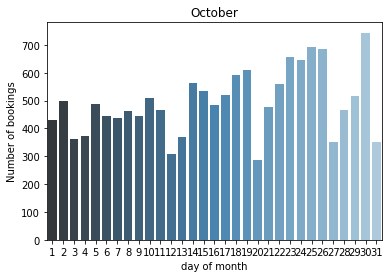

In [59]:
#Distribution Number of bookings per month
# bremen_trips.start_time.dt.day.value_counts()
day_of_month_jan = bremen_trips[bremen_trips['start_time'].dt.month == 10].start_time.dt.day.value_counts()
ax = sns.barplot(x=day_of_month_jan.index, y=day_of_month_jan, palette="Blues_d")
ax.set(ylabel='Number of bookings', xlabel='day of month') 
ax.set_title('October')

### 16.10 Mittwoch # Keine Besonderen Events 

In [60]:
df_1610 = bremen_trips.loc[bremen_trips['booking_date'] == "2019-10-16"]
display(df_1610,len(df_1610.duplicated(['start_time', 'end_time'],keep='last')))

,bike,bike_type,identification,start_time,end_time,duration_sec,start_lng,start_lat,end_lng,end_lat,start_place,end_place,month,booking_date,weekdays,hour,duration_min
41317,20600,71,23499699,2019-10-16 00:20:00,2019-10-16 00:33:00,780.0,8.824347,53.072982,8.850425,53.071267,0.0,0.0,10,2019-10-16,2,0,13.0
159322,20846,71,7873805,2019-10-16 00:32:00,2019-10-16 00:50:00,1080.0,8.807174,53.095338,8.799639,53.069444,0.0,2962.0,10,2019-10-16,2,0,18.0
134409,20799,71,23499872,2019-10-16 00:38:00,2019-10-16 00:46:00,480.0,8.817620,53.083653,8.826828,53.082627,0.0,0.0,10,2019-10-16,2,0,8.0
74449,20668,71,23499945,2019-10-16 00:42:00,2019-10-16 00:51:00,540.0,8.831167,53.074278,8.843348,53.073658,2948.0,0.0,10,2019-10-16,2,0,9.0
34397,20587,71,23500740,2019-10-16 01:24:00,2019-10-16 01:52:00,1680.0,8.778334,53.076302,8.855911,53.070742,0.0,0.0,10,2019-10-16,2,1,28.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
101380,20725,71,23549399,2019-10-16 23:01:00,2019-10-16 23:19:00,1080.0,8.830991,53.097828,8.800110,53.084960,2916.0,0.0,10,2019-10-16,2,23,18.0
45193,20609,71,23549493,2019-10-16 23:06:00,2019-10-16 23:24:00,1080.0,8.824919,53.073933,8.803704,53.064827,0.0,0.0,10,2019-10-16,2,23,18.0
41323,20600,71,23549639,2019-10-16 23:28:00,2019-10-16 23:33:00,300.0,8.854952,53.081658,8.855616,53.082227,0.0,0.0,10,2019-10-16,2,23,5.0
61280,20642,71,23549988,2019-10-16 23:45:00,2019-10-16 23:58:00,780.0,8.809893,53.082627,8.793257,53.092422,0.0,0.0,10,2019-10-16,2,23,13.0


484

In [61]:
# Heatmap über gesamten Tag
base_map = generateBaseMap(default_location=[53.108610,8.853722])
HeatMap(data=df_1610[['end_lat', 'end_lng', 'duration_min']].groupby(['end_lat', 'end_lng']).sum().reset_index().values.tolist(), radius=8, max_zoom=13).add_to(base_map)
base_map

### 24.10 Donnertsag # keine besonderen events

In [62]:
df_2410 = bremen_trips.loc[bremen_trips['booking_date'] == "2019-10-24"]
display(df_2410,len(df_2410.duplicated(['start_time', 'end_time'],keep='last')))

,bike,bike_type,identification,start_time,end_time,duration_sec,start_lng,start_lat,end_lng,end_lat,start_place,end_place,month,booking_date,weekdays,hour,duration_min
71925,20661,71,10551452,2019-10-24 00:04:00,2019-10-24 00:37:00,1980.0,8.820019,53.074240,8.859170,53.102933,0.0,2992.0,10,2019-10-24,3,0,33.0
87628,20697,71,23915730,2019-10-24 00:06:00,2019-10-24 00:12:00,360.0,8.808646,53.082067,8.808672,53.081893,0.0,0.0,10,2019-10-24,3,0,6.0
183809,20893,71,23915905,2019-10-24 00:08:00,2019-10-24 00:22:00,840.0,8.810852,53.073484,8.843983,53.070120,0.0,0.0,10,2019-10-24,3,0,14.0
114657,20754,71,10551452,2019-10-24 00:08:00,2019-10-24 00:37:00,1740.0,8.821137,53.075627,8.859170,53.102933,0.0,2992.0,10,2019-10-24,3,0,29.0
28761,20575,71,23915904,2019-10-24 00:11:00,2019-10-24 00:23:00,720.0,8.810503,53.072493,8.844617,53.070369,0.0,0.0,10,2019-10-24,3,0,12.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
167633,20862,71,23974874,2019-10-24 23:46:00,2019-10-24 23:55:00,540.0,8.813184,53.085858,8.801112,53.094591,0.0,0.0,10,2019-10-24,3,23,9.0
18340,20553,71,23975081,2019-10-24 23:50:00,2019-10-25 00:05:00,900.0,8.873420,53.084924,8.856843,53.082324,0.0,0.0,10,2019-10-24,3,23,15.0
155259,20837,71,23975004,2019-10-24 23:52:00,2019-10-25 00:01:00,540.0,8.821366,53.079164,8.835848,53.070662,0.0,0.0,10,2019-10-24,3,23,9.0
114089,20753,71,23975053,2019-10-24 23:55:00,2019-10-25 00:04:00,540.0,8.815487,53.084724,8.791830,53.090907,0.0,0.0,10,2019-10-24,3,23,9.0


646

In [163]:
# Heatmap über gesamten Tag
base_map = generateBaseMap(default_location=[53.108610,8.853722])
HeatMap(data=df_2410[['end_lat', 'end_lng', 'duration_min']].groupby(['end_lat', 'end_lng']).sum().reset_index().values.tolist(), radius=8, max_zoom=13).add_to(base_map)
base_map

### 2.d Visualize the distribution of trip lengths per month. Compare the distributions to normal distributions with mean and standard deviation as calculated before (1.d))